# RHEED Metrics with Details

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import glob
import sys
sys.path.append('../../src/')

import os
import re
import numpy as np
import matplotlib.pyplot as plt

from m3_learning.util.file_IO import download_and_unzip
from m3_learning.RHEED.Dataset import RHEED_spot_Dataset, RHEED_parameter_dataset
from m3_learning.RHEED.Viz import Viz
from m3_learning.RHEED.Fit import RHEED_image_processer, Gaussian

### 2.1 direct beam

In [25]:
path = 'F:/UMich/BeamCurrentLinearityTest.h5'
ds_bg = RHEED_spot_Dataset(path, sample_name='ds_bg')
ds_bg.data_info

Growth: DiffractedBeam_1microAmp, Size of data: f(22952, 480, 640)
Growth: DiffractedBeam_point2microAmps, Size of data: f(21862, 480, 640)
Growth: DiffractedBeam_point3microAmps, Size of data: f(22336, 480, 640)
Growth: DiffractedBeam_point4microAmps, Size of data: f(22015, 480, 640)
Growth: DiffractedBeam_point5microAmps, Size of data: f(21818, 480, 640)
Growth: DiffractedBeam_point6microAmps, Size of data: f(22961, 480, 640)
Growth: DiffractedBeam_point6microAmps_CORRECT, Size of data: f(22061, 480, 640)
Growth: DiffractedBeam_point7microAmps, Size of data: f(22793, 480, 640)
Growth: DiffractedBeam_point8microAmps, Size of data: f(22491, 480, 640)
Growth: DiffractedBeam_point9microAmps, Size of data: f(22081, 480, 640)
Growth: DirectBeam_1microAmp, Size of data: f(22897, 480, 640)
Growth: DirectBeam_point2microAmps, Size of data: f(22275, 480, 640)
Growth: DirectBeam_point3microAmps, Size of data: f(21741, 480, 640)
Growth: DirectBeam_point4microAmps, Size of data: f(22006, 480, 640

#### 2.1.2 Locate the diffraction spots

In [8]:
growth_name = 'DirectBeam_point6microAmps'
ds_bg.viz_RHEED_spot(growth=growth_name, index=10000, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for DirectBeam_point6microAmps at index 10000.


<Figure size 800x600 with 0 Axes>

In [7]:
growth_name = 'DirectBeam_point2microAmps'
ds_bg.viz_RHEED_spot(growth=growth_name, index=10000, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for DirectBeam_point2microAmps at index 10000.


<Figure size 800x600 with 0 Axes>

In [6]:
growth_name = 'DirectBeam_1microAmp'
ds_bg.viz_RHEED_spot(growth=growth_name, index=10000, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for DirectBeam_1microAmp at index 10000.


<Figure size 800x600 with 0 Axes>

#### 2.1.3 Visualize an example

DirectBeam_1microAmp


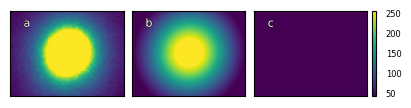

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_1microAmp at index 0.
The Gaussian fitted parameters are: img_sum=347365.00, img_max=255.00, img_mean=128.65,
img_rec_sum=335058.10, img_rec_max=287.87, img_rec_mean=124.10,
height=287.99, x=39.12, y=50.38, width_x=15.47, width_y_max=15.02.


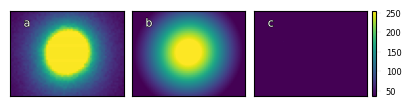

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_1microAmp at index 21000.
The Gaussian fitted parameters are: img_sum=320808.00, img_max=255.00, img_mean=118.82,
img_rec_sum=306812.34, img_rec_max=284.27, img_rec_mean=113.63,
height=284.42, x=9.23, y=43.28, width_x=14.20, width_y_max=14.64.
DirectBeam_point2microAmps


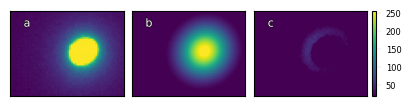

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point2microAmps at index 0.
The Gaussian fitted parameters are: img_sum=160472.00, img_max=255.00, img_mean=59.43,
img_rec_sum=125530.40, img_rec_max=265.02, img_rec_mean=46.49,
height=265.37, x=1.75, y=58.36, width_x=8.61, width_y_max=9.25.


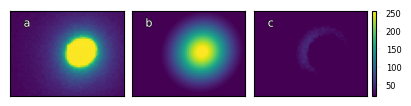

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point2microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=177668.00, img_max=255.00, img_mean=65.80,
img_rec_sum=145990.87, img_rec_max=263.20, img_rec_mean=54.07,
height=263.66, x=8.34, y=52.92, width_x=9.40, width_y_max=10.00.
DirectBeam_point3microAmps


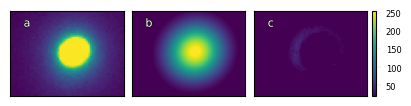

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point3microAmps at index 0.
The Gaussian fitted parameters are: img_sum=188597.00, img_max=255.00, img_mean=69.85,
img_rec_sum=159785.40, img_rec_max=260.67, img_rec_mean=59.18,
height=260.81, x=16.94, y=41.41, width_x=9.92, width_y_max=10.51.


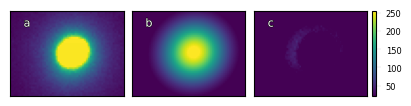

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point3microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=207819.00, img_max=255.00, img_mean=76.97,
img_rec_sum=182493.77, img_rec_max=264.41, img_rec_mean=67.59,
height=264.65, x=19.08, y=38.55, width_x=10.60, width_y_max=11.21.
DirectBeam_point4microAmps


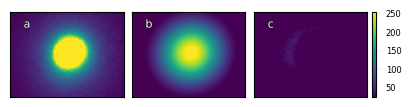

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point4microAmps at index 0.
The Gaussian fitted parameters are: img_sum=212538.00, img_max=254.00, img_mean=78.72,
img_rec_sum=187936.35, img_rec_max=262.90, img_rec_mean=69.61,
height=263.25, x=19.16, y=36.61, width_x=10.82, width_y_max=11.41.


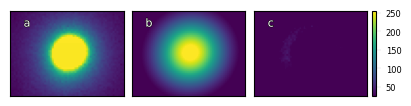

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point4microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=240662.00, img_max=255.00, img_mean=89.13,
img_rec_sum=219905.42, img_rec_max=270.11, img_rec_mean=81.45,
height=270.19, x=20.20, y=35.36, width_x=11.69, width_y_max=12.30.
DirectBeam_point5microAmps


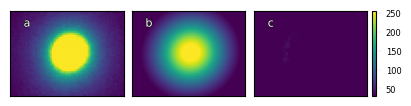

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point5microAmps at index 0.
The Gaussian fitted parameters are: img_sum=258943.00, img_max=255.00, img_mean=95.90,
img_rec_sum=239978.56, img_rec_max=272.99, img_rec_mean=88.88,
height=273.15, x=20.20, y=35.48, width_x=12.26, width_y_max=12.87.


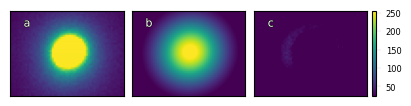

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point5microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=230961.00, img_max=255.00, img_mean=85.54,
img_rec_sum=208869.59, img_rec_max=266.85, img_rec_mean=77.36,
height=267.03, x=19.41, y=35.82, width_x=11.43, width_y_max=12.00.
DirectBeam_point6microAmps


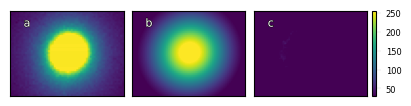

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point6microAmps at index 0.
The Gaussian fitted parameters are: img_sum=280264.00, img_max=255.00, img_mean=103.80,
img_rec_sum=263334.78, img_rec_max=277.59, img_rec_mean=97.53,
height=277.67, x=19.20, y=36.22, width_x=12.93, width_y_max=13.46.


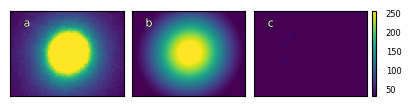

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point6microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=295726.00, img_max=255.00, img_mean=109.53,
img_rec_sum=280035.25, img_rec_max=280.87, img_rec_mean=103.72,
height=280.93, x=19.30, y=36.18, width_x=13.37, width_y_max=13.91.
DirectBeam_point7microAmps


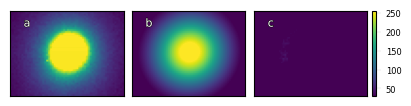

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=273899.00, img_max=255.00, img_mean=101.44,
img_rec_sum=256263.20, img_rec_max=275.87, img_rec_mean=94.91,
height=276.10, x=18.50, y=36.75, width_x=12.75, width_y_max=13.29.


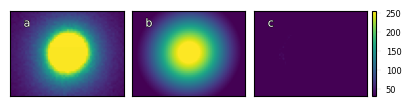

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=285456.00, img_max=255.00, img_mean=105.72,
img_rec_sum=268968.37, img_rec_max=278.37, img_rec_mean=99.62,
height=278.60, x=19.08, y=35.98, width_x=13.09, width_y_max=13.61.
DirectBeam_point8microAmps


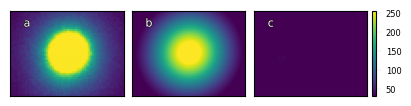

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point8microAmps at index 0.
The Gaussian fitted parameters are: img_sum=296307.00, img_max=255.00, img_mean=109.74,
img_rec_sum=280619.00, img_rec_max=279.84, img_rec_mean=103.93,
height=279.95, x=17.49, y=37.94, width_x=13.47, width_y_max=13.92.


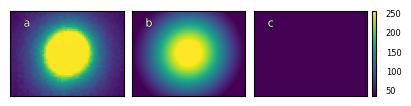

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point8microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=320805.00, img_max=255.00, img_mean=118.82,
img_rec_sum=307041.15, img_rec_max=284.58, img_rec_mean=113.72,
height=284.63, x=14.96, y=39.82, width_x=14.19, width_y_max=14.64.
DirectBeam_point9microAmps


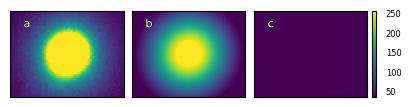

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point9microAmps at index 0.
The Gaussian fitted parameters are: img_sum=320269.00, img_max=255.00, img_mean=118.62,
img_rec_sum=306392.80, img_rec_max=284.32, img_rec_mean=113.48,
height=284.46, x=12.47, y=41.67, width_x=14.18, width_y_max=14.62.


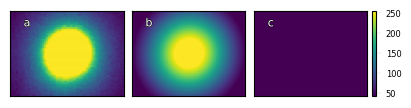

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point9microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=356800.00, img_max=255.00, img_mean=132.15,
img_rec_sum=345228.24, img_rec_max=289.33, img_rec_mean=127.86,
height=289.48, x=39.12, y=50.03, width_x=15.75, width_y_max=15.31.


In [24]:
for dataset in ds_bg.dataset_names:
    if 'DirectBeam' in dataset:
        print(dataset)
        crop_dict = {'spot': {'y_start':210, 'y_end':255, 'x_start':252, 'x_end':312}}
        start_index, end_index = 0, 21000
        fit_function = Gaussian().recreate_gaussian
        processor = RHEED_image_processer(ds_bg, crop_dict, fit_function)
        img, img_rec, parameters = processor.visualize(growth=dataset, spot='spot', frame=start_index, figsize=(4,8))
        img, img_rec, parameters = processor.visualize(growth=dataset, spot='spot', frame=end_index, figsize=(4,8))

#### 2.1.4 preview metric in time

In [ ]:
# %%time
# fit_function = Gaussian().recreate_gaussian
# processor = RHEED_image_processer(ds_spot350C, crop_dict, fit_function)
# processor.preview_metric(growth='temp350', spot='spot_2', metric='mean', 
#                          camera_freq=2000)

#### 2.1.4 generate the dataset

In [26]:
%%time
parameters_file_path = 'F:/UMich/BeamCurrentLinearityTest_gaussian_fit_parameter.h5'

fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_bg, crop_dict, fit_function)
processor.write_h5_file(parameters_file_path, growth_list=ds_bg.dataset_names, replace=False, num_workers=12)

DiffractedBeam_1microAmp:
  spot generation started:
DiffractedBeam_point2microAmps:
  spot generation started:
DiffractedBeam_point3microAmps:
  spot generation started:
DiffractedBeam_point4microAmps:
  spot generation started:
DiffractedBeam_point5microAmps:
  spot generation started:
DiffractedBeam_point6microAmps:
  spot generation started:
DiffractedBeam_point6microAmps_CORRECT:
  spot generation started:
DiffractedBeam_point7microAmps:
  spot generation started:
DiffractedBeam_point8microAmps:
  spot generation started:
DiffractedBeam_point9microAmps:
  spot generation started:
DirectBeam_1microAmp:
  spot generation started:
DirectBeam_point2microAmps:
  spot generation started:
DirectBeam_point3microAmps:
  spot generation started:
DirectBeam_point4microAmps:
  spot generation started:
DirectBeam_point5microAmps:
  spot generation started:
DirectBeam_point6microAmps:
  spot generation started:
DirectBeam_point7microAmps:
  spot generation started:
DirectBeam_point8microAmps:
 

#### 2.1.5 Exam the dataset

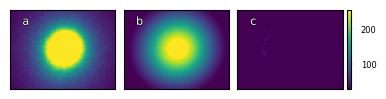

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point6microAmps at index 0.
img_sum=280264.00, img_max=255.00, img_mean=103.80
img_rec_sum=263334.78, img_rec_max=277.59, img_rec_mean=97.53
height=277.67, x=19.20, y=36.22, width_x=12.93, width_y_max=13.46


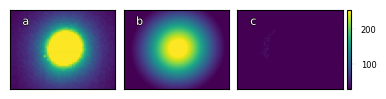

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point6microAmps at index 10500.
img_sum=266031.00, img_max=255.00, img_mean=98.53
img_rec_sum=247681.65, img_rec_max=274.28, img_rec_mean=91.73
height=274.44, x=19.58, y=35.81, width_x=12.50, width_y_max=13.07


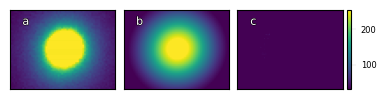

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DirectBeam_point6microAmps at index 21000.
img_sum=295726.00, img_max=255.00, img_mean=109.53
img_rec_sum=280035.25, img_rec_max=280.87, img_rec_mean=103.72
height=280.93, x=19.30, y=36.18, width_x=13.37, width_y_max=13.91


I:\RHEED_data\m3_learning\m3_learning\papers\2023_RHEED_PLD_umich\../../src\m3_learning\RHEED\Dataset.py:509: UserWarning:

FixedFormatter should only be used together with FixedLocator



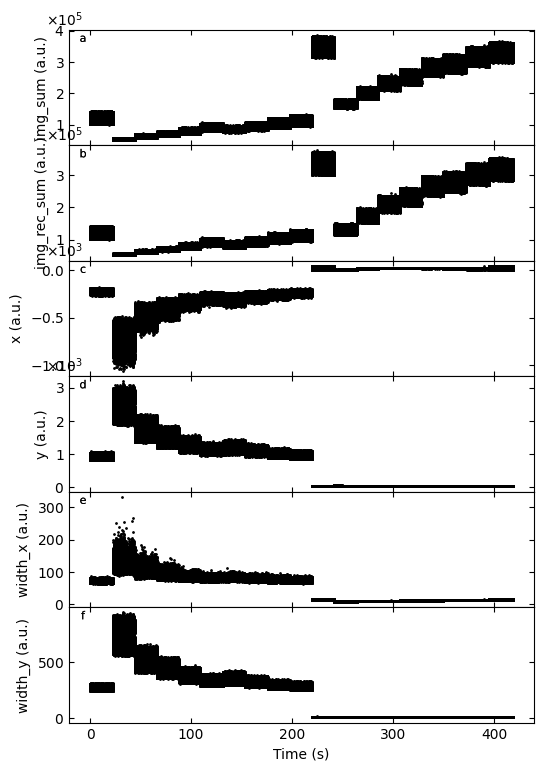

Gaussian fitted parameters in time: Fig. a: sum of original image, b: sum of reconstructed image, c: spot center in spot x coordinate, d: spot center in y coordinate, e: spot width in x coordinate, f: spot width in y coordinate.


In [29]:
parameters_file_path = 'F:/UMich/BeamCurrentLinearityTest_gaussian_fit_parameter.h5'
D1_para = RHEED_parameter_dataset(parameters_file_path, camera_freq=1000, sample_name='DirectBeam')

D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot', index=start_index)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot', index=end_index//2)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot', index=end_index)
D1_para.viz_RHEED_parameter_trend(ds_bg.dataset_names, spot='spot', head_tail=(100,300))

### 2.2 Diffracted spots

In [31]:
path = 'F:/UMich/BeamCurrentLinearityTest.h5'
ds_bg = RHEED_spot_Dataset(path, sample_name='ds_bg')
ds_bg.data_info

Growth: DiffractedBeam_1microAmp, Size of data: f(22952, 480, 640)
Growth: DiffractedBeam_point2microAmps, Size of data: f(21862, 480, 640)
Growth: DiffractedBeam_point3microAmps, Size of data: f(22336, 480, 640)
Growth: DiffractedBeam_point4microAmps, Size of data: f(22015, 480, 640)
Growth: DiffractedBeam_point5microAmps, Size of data: f(21818, 480, 640)
Growth: DiffractedBeam_point6microAmps, Size of data: f(22961, 480, 640)
Growth: DiffractedBeam_point6microAmps_CORRECT, Size of data: f(22061, 480, 640)
Growth: DiffractedBeam_point7microAmps, Size of data: f(22793, 480, 640)
Growth: DiffractedBeam_point8microAmps, Size of data: f(22491, 480, 640)
Growth: DiffractedBeam_point9microAmps, Size of data: f(22081, 480, 640)
Growth: DirectBeam_1microAmp, Size of data: f(22897, 480, 640)
Growth: DirectBeam_point2microAmps, Size of data: f(22275, 480, 640)
Growth: DirectBeam_point3microAmps, Size of data: f(21741, 480, 640)
Growth: DirectBeam_point4microAmps, Size of data: f(22006, 480, 640

#### 2.2.2 Locate the diffraction spots

In [39]:
growth_name = 'DiffractedBeam_point2microAmps'
ds_bg.viz_RHEED_spot(growth=growth_name, index=10000, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for DiffractedBeam_point2microAmps at index 10000.


<Figure size 800x600 with 0 Axes>

In [40]:
growth_name = 'DiffractedBeam_point7microAmps'
ds_bg.viz_RHEED_spot(growth=growth_name, index=10000, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for DiffractedBeam_point7microAmps at index 10000.


<Figure size 800x600 with 0 Axes>

In [38]:
growth_name = 'DiffractedBeam_1microAmp'
ds_bg.viz_RHEED_spot(growth=growth_name, index=10000, figsize=(8,6), viz_mode='iteractive')

Fig. a: RHEED spot image for DiffractedBeam_1microAmp at index 10000.


<Figure size 800x600 with 0 Axes>

#### 2.2.3 Visualize an example

DiffractedBeam_1microAmp


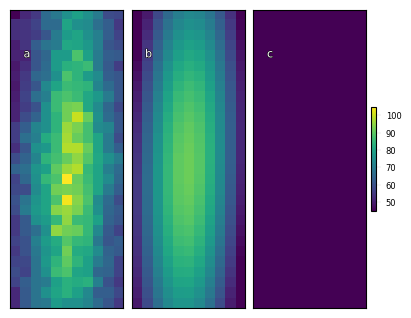

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=23058.00, img_max=105.00, img_mean=72.28,
img_rec_sum=22265.53, img_rec_max=91.62, img_rec_mean=69.80,
height=91.66, x=15.39, y=5.35, width_x=22.86, width_y_max=5.25.


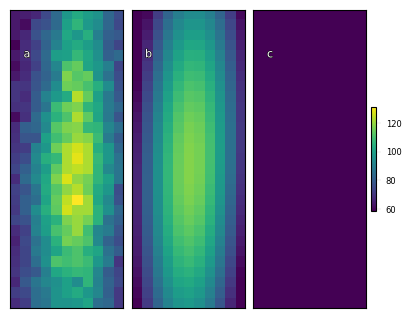

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=29546.00, img_max=131.00, img_mean=92.62,
img_rec_sum=28636.01, img_rec_max=117.74, img_rec_mean=89.77,
height=117.81, x=15.11, y=5.67, width_x=22.70, width_y_max=5.27.


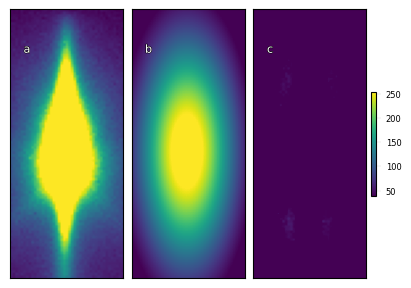

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=578037.00, img_max=255.00, img_mean=131.79,
img_rec_sum=561849.26, img_rec_max=285.05, img_rec_mean=128.10,
height=285.11, x=53.96, y=20.68, width_x=30.28, width_y_max=-12.93.


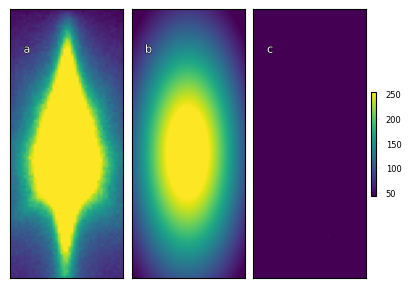

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=687028.00, img_max=255.00, img_mean=156.64,
img_rec_sum=675713.02, img_rec_max=292.23, img_rec_mean=154.06,
height=292.35, x=54.60, y=20.92, width_x=33.53, width_y_max=-15.28.


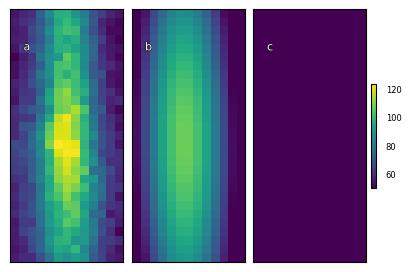

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=29602.00, img_max=124.00, img_mean=78.52,
img_rec_sum=28246.05, img_rec_max=107.25, img_rec_mean=74.92,
height=107.89, x=15.22, y=5.96, width_x=22.92, width_y_max=4.97.


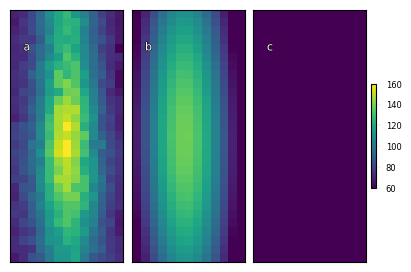

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=38014.00, img_max=160.00, img_mean=100.83,
img_rec_sum=36291.97, img_rec_max=137.75, img_rec_mean=96.27,
height=138.46, x=14.78, y=6.00, width_x=22.15, width_y_max=5.02.
DiffractedBeam_point2microAmps


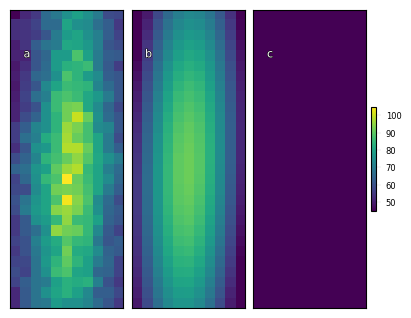

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=23058.00, img_max=105.00, img_mean=72.28,
img_rec_sum=22265.53, img_rec_max=91.62, img_rec_mean=69.80,
height=91.66, x=15.39, y=5.35, width_x=22.86, width_y_max=5.25.


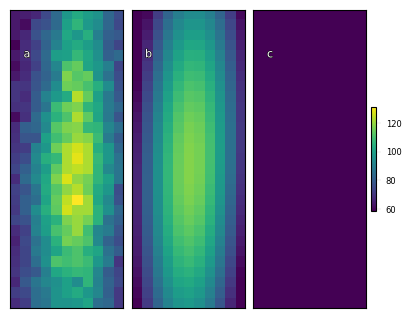

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=29546.00, img_max=131.00, img_mean=92.62,
img_rec_sum=28636.01, img_rec_max=117.74, img_rec_mean=89.77,
height=117.81, x=15.11, y=5.67, width_x=22.70, width_y_max=5.27.


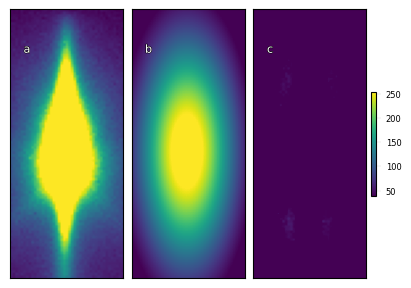

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=578037.00, img_max=255.00, img_mean=131.79,
img_rec_sum=561849.26, img_rec_max=285.05, img_rec_mean=128.10,
height=285.11, x=53.96, y=20.68, width_x=30.28, width_y_max=-12.93.


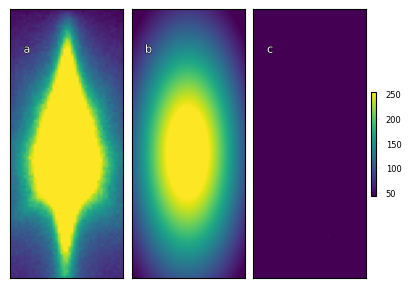

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=687028.00, img_max=255.00, img_mean=156.64,
img_rec_sum=675713.02, img_rec_max=292.23, img_rec_mean=154.06,
height=292.35, x=54.60, y=20.92, width_x=33.53, width_y_max=-15.28.


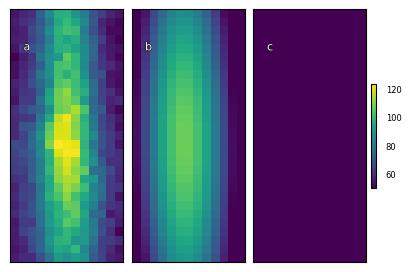

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=29602.00, img_max=124.00, img_mean=78.52,
img_rec_sum=28246.05, img_rec_max=107.25, img_rec_mean=74.92,
height=107.89, x=15.22, y=5.96, width_x=22.92, width_y_max=4.97.


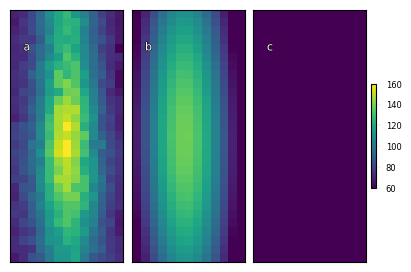

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=38014.00, img_max=160.00, img_mean=100.83,
img_rec_sum=36291.97, img_rec_max=137.75, img_rec_mean=96.27,
height=138.46, x=14.78, y=6.00, width_x=22.15, width_y_max=5.02.
DiffractedBeam_point3microAmps


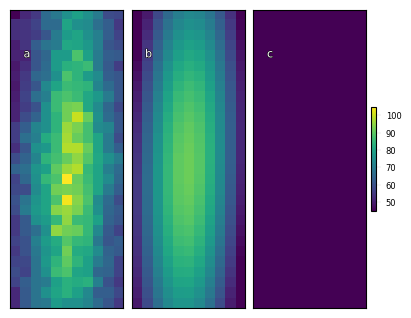

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=23058.00, img_max=105.00, img_mean=72.28,
img_rec_sum=22265.53, img_rec_max=91.62, img_rec_mean=69.80,
height=91.66, x=15.39, y=5.35, width_x=22.86, width_y_max=5.25.


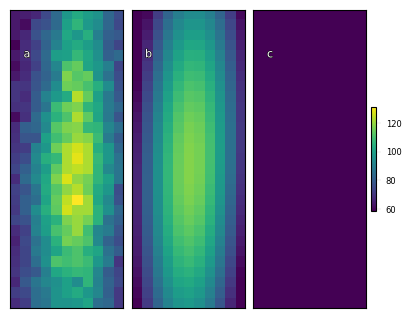

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=29546.00, img_max=131.00, img_mean=92.62,
img_rec_sum=28636.01, img_rec_max=117.74, img_rec_mean=89.77,
height=117.81, x=15.11, y=5.67, width_x=22.70, width_y_max=5.27.


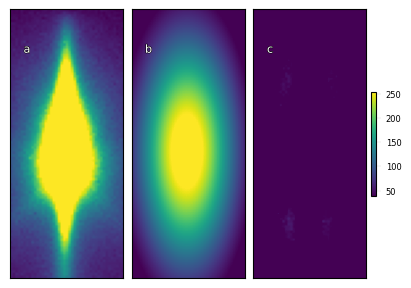

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=578037.00, img_max=255.00, img_mean=131.79,
img_rec_sum=561849.26, img_rec_max=285.05, img_rec_mean=128.10,
height=285.11, x=53.96, y=20.68, width_x=30.28, width_y_max=-12.93.


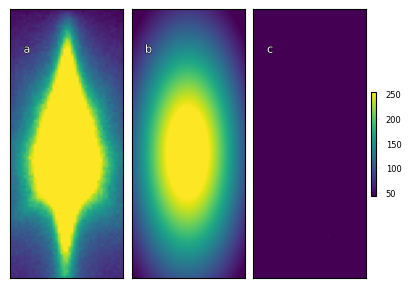

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=687028.00, img_max=255.00, img_mean=156.64,
img_rec_sum=675713.02, img_rec_max=292.23, img_rec_mean=154.06,
height=292.35, x=54.60, y=20.92, width_x=33.53, width_y_max=-15.28.


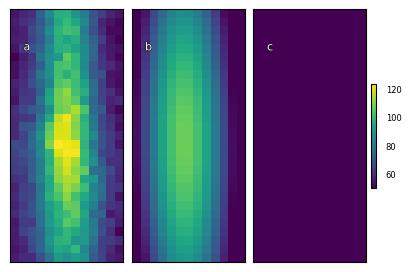

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=29602.00, img_max=124.00, img_mean=78.52,
img_rec_sum=28246.05, img_rec_max=107.25, img_rec_mean=74.92,
height=107.89, x=15.22, y=5.96, width_x=22.92, width_y_max=4.97.


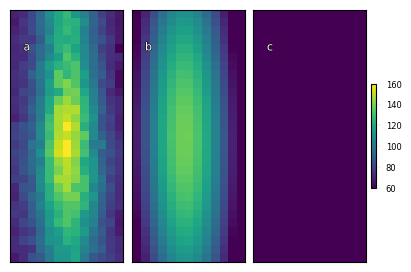

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=38014.00, img_max=160.00, img_mean=100.83,
img_rec_sum=36291.97, img_rec_max=137.75, img_rec_mean=96.27,
height=138.46, x=14.78, y=6.00, width_x=22.15, width_y_max=5.02.
DiffractedBeam_point4microAmps


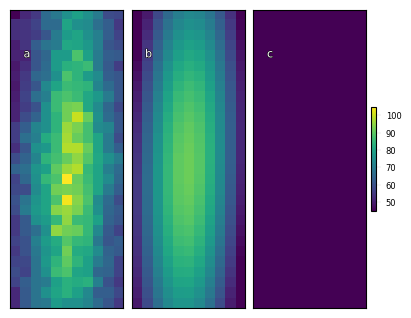

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=23058.00, img_max=105.00, img_mean=72.28,
img_rec_sum=22265.53, img_rec_max=91.62, img_rec_mean=69.80,
height=91.66, x=15.39, y=5.35, width_x=22.86, width_y_max=5.25.


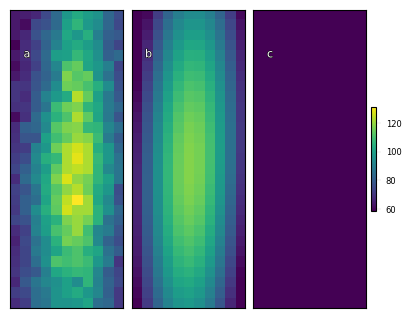

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=29546.00, img_max=131.00, img_mean=92.62,
img_rec_sum=28636.01, img_rec_max=117.74, img_rec_mean=89.77,
height=117.81, x=15.11, y=5.67, width_x=22.70, width_y_max=5.27.


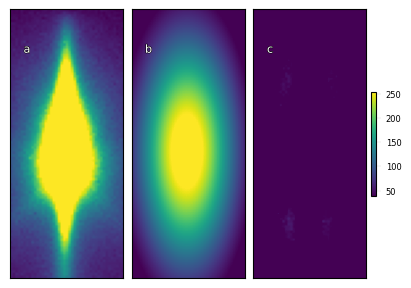

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=578037.00, img_max=255.00, img_mean=131.79,
img_rec_sum=561849.26, img_rec_max=285.05, img_rec_mean=128.10,
height=285.11, x=53.96, y=20.68, width_x=30.28, width_y_max=-12.93.


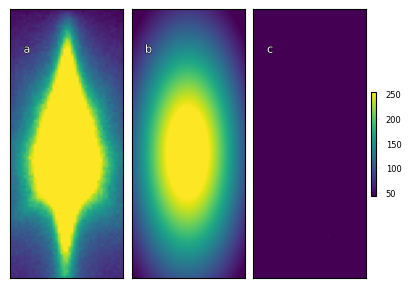

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=687028.00, img_max=255.00, img_mean=156.64,
img_rec_sum=675713.02, img_rec_max=292.23, img_rec_mean=154.06,
height=292.35, x=54.60, y=20.92, width_x=33.53, width_y_max=-15.28.


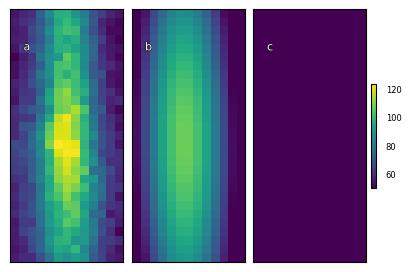

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=29602.00, img_max=124.00, img_mean=78.52,
img_rec_sum=28246.05, img_rec_max=107.25, img_rec_mean=74.92,
height=107.89, x=15.22, y=5.96, width_x=22.92, width_y_max=4.97.


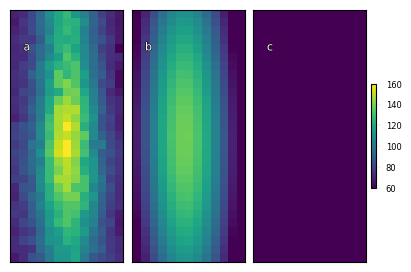

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=38014.00, img_max=160.00, img_mean=100.83,
img_rec_sum=36291.97, img_rec_max=137.75, img_rec_mean=96.27,
height=138.46, x=14.78, y=6.00, width_x=22.15, width_y_max=5.02.
DiffractedBeam_point5microAmps


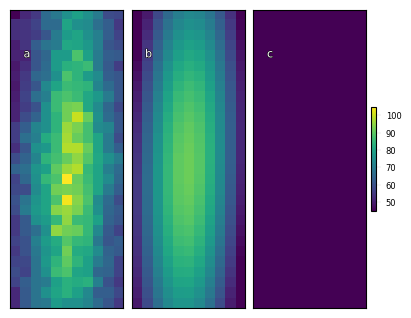

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=23058.00, img_max=105.00, img_mean=72.28,
img_rec_sum=22265.53, img_rec_max=91.62, img_rec_mean=69.80,
height=91.66, x=15.39, y=5.35, width_x=22.86, width_y_max=5.25.


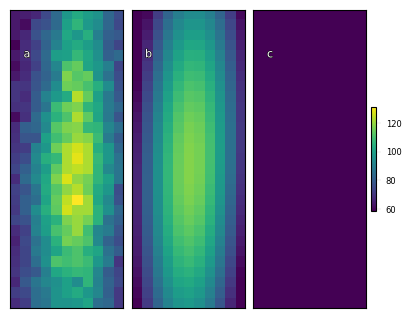

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=29546.00, img_max=131.00, img_mean=92.62,
img_rec_sum=28636.01, img_rec_max=117.74, img_rec_mean=89.77,
height=117.81, x=15.11, y=5.67, width_x=22.70, width_y_max=5.27.


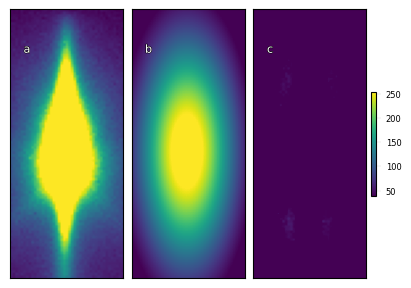

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=578037.00, img_max=255.00, img_mean=131.79,
img_rec_sum=561849.26, img_rec_max=285.05, img_rec_mean=128.10,
height=285.11, x=53.96, y=20.68, width_x=30.28, width_y_max=-12.93.


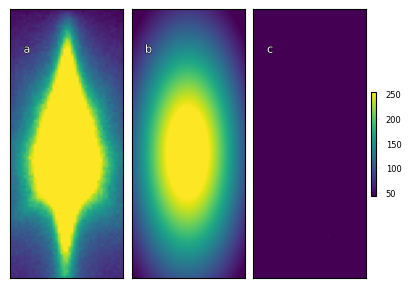

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=687028.00, img_max=255.00, img_mean=156.64,
img_rec_sum=675713.02, img_rec_max=292.23, img_rec_mean=154.06,
height=292.35, x=54.60, y=20.92, width_x=33.53, width_y_max=-15.28.


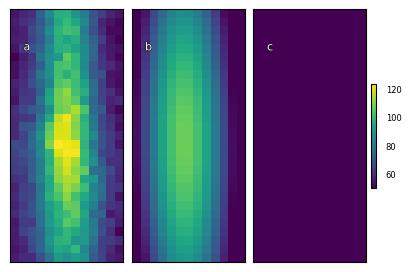

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=29602.00, img_max=124.00, img_mean=78.52,
img_rec_sum=28246.05, img_rec_max=107.25, img_rec_mean=74.92,
height=107.89, x=15.22, y=5.96, width_x=22.92, width_y_max=4.97.


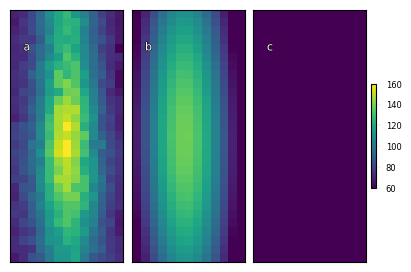

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=38014.00, img_max=160.00, img_mean=100.83,
img_rec_sum=36291.97, img_rec_max=137.75, img_rec_mean=96.27,
height=138.46, x=14.78, y=6.00, width_x=22.15, width_y_max=5.02.
DiffractedBeam_point6microAmps


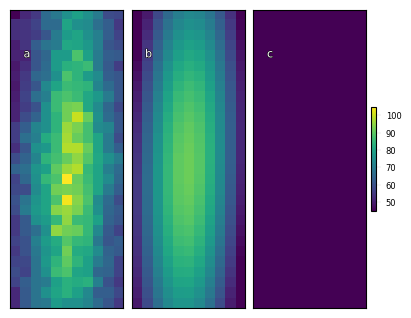

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=23058.00, img_max=105.00, img_mean=72.28,
img_rec_sum=22265.53, img_rec_max=91.62, img_rec_mean=69.80,
height=91.66, x=15.39, y=5.35, width_x=22.86, width_y_max=5.25.


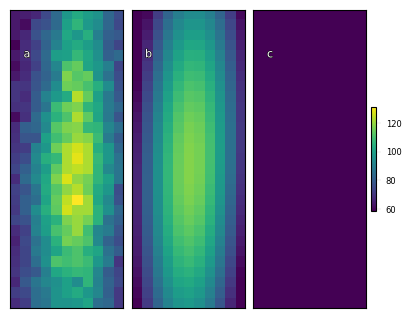

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=29546.00, img_max=131.00, img_mean=92.62,
img_rec_sum=28636.01, img_rec_max=117.74, img_rec_mean=89.77,
height=117.81, x=15.11, y=5.67, width_x=22.70, width_y_max=5.27.


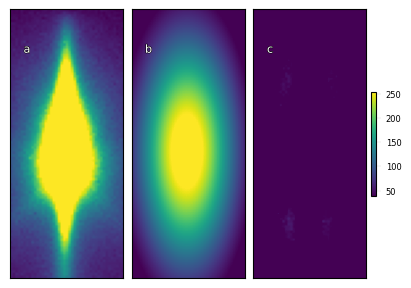

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=578037.00, img_max=255.00, img_mean=131.79,
img_rec_sum=561849.26, img_rec_max=285.05, img_rec_mean=128.10,
height=285.11, x=53.96, y=20.68, width_x=30.28, width_y_max=-12.93.


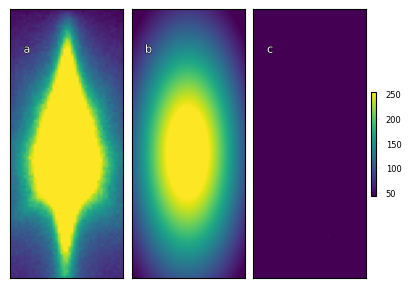

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=687028.00, img_max=255.00, img_mean=156.64,
img_rec_sum=675713.02, img_rec_max=292.23, img_rec_mean=154.06,
height=292.35, x=54.60, y=20.92, width_x=33.53, width_y_max=-15.28.


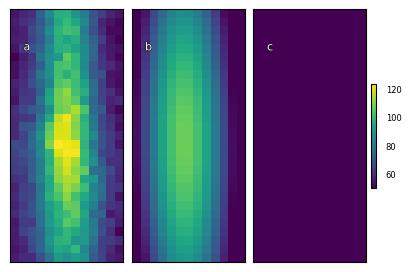

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=29602.00, img_max=124.00, img_mean=78.52,
img_rec_sum=28246.05, img_rec_max=107.25, img_rec_mean=74.92,
height=107.89, x=15.22, y=5.96, width_x=22.92, width_y_max=4.97.


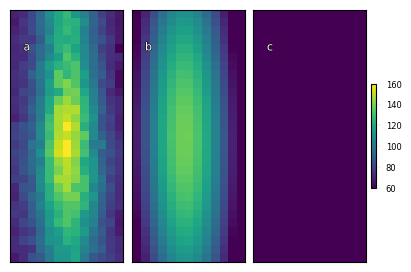

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=38014.00, img_max=160.00, img_mean=100.83,
img_rec_sum=36291.97, img_rec_max=137.75, img_rec_mean=96.27,
height=138.46, x=14.78, y=6.00, width_x=22.15, width_y_max=5.02.
DiffractedBeam_point6microAmps_CORRECT


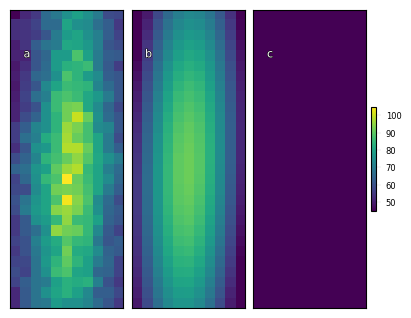

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=23058.00, img_max=105.00, img_mean=72.28,
img_rec_sum=22265.53, img_rec_max=91.62, img_rec_mean=69.80,
height=91.66, x=15.39, y=5.35, width_x=22.86, width_y_max=5.25.


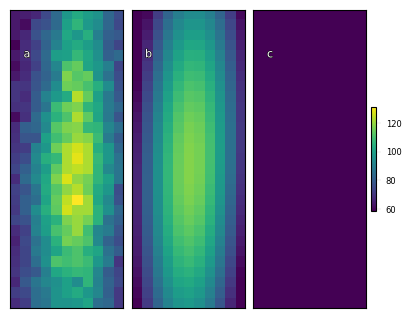

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=29546.00, img_max=131.00, img_mean=92.62,
img_rec_sum=28636.01, img_rec_max=117.74, img_rec_mean=89.77,
height=117.81, x=15.11, y=5.67, width_x=22.70, width_y_max=5.27.


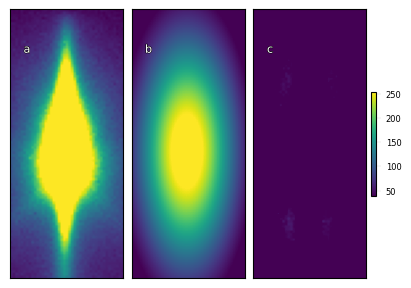

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=578037.00, img_max=255.00, img_mean=131.79,
img_rec_sum=561849.26, img_rec_max=285.05, img_rec_mean=128.10,
height=285.11, x=53.96, y=20.68, width_x=30.28, width_y_max=-12.93.


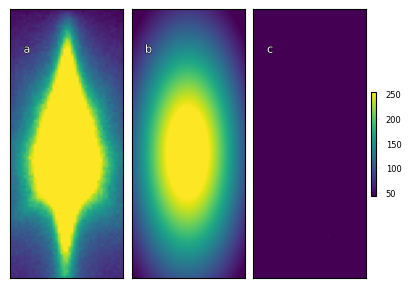

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=687028.00, img_max=255.00, img_mean=156.64,
img_rec_sum=675713.02, img_rec_max=292.23, img_rec_mean=154.06,
height=292.35, x=54.60, y=20.92, width_x=33.53, width_y_max=-15.28.


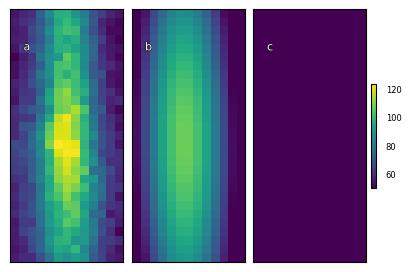

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=29602.00, img_max=124.00, img_mean=78.52,
img_rec_sum=28246.05, img_rec_max=107.25, img_rec_mean=74.92,
height=107.89, x=15.22, y=5.96, width_x=22.92, width_y_max=4.97.


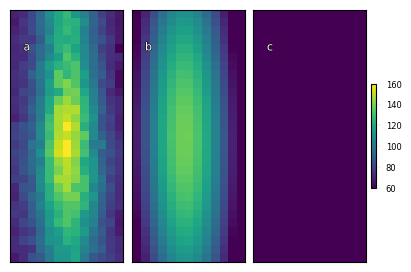

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=38014.00, img_max=160.00, img_mean=100.83,
img_rec_sum=36291.97, img_rec_max=137.75, img_rec_mean=96.27,
height=138.46, x=14.78, y=6.00, width_x=22.15, width_y_max=5.02.
DiffractedBeam_point7microAmps


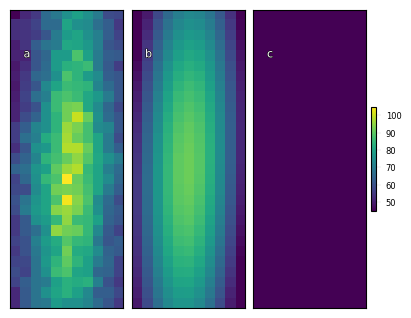

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=23058.00, img_max=105.00, img_mean=72.28,
img_rec_sum=22265.53, img_rec_max=91.62, img_rec_mean=69.80,
height=91.66, x=15.39, y=5.35, width_x=22.86, width_y_max=5.25.


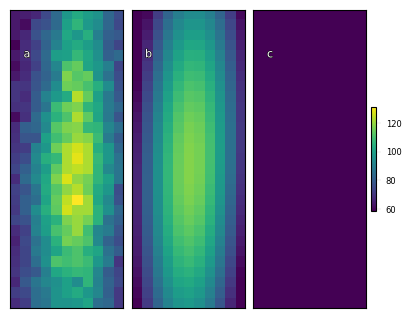

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=29546.00, img_max=131.00, img_mean=92.62,
img_rec_sum=28636.01, img_rec_max=117.74, img_rec_mean=89.77,
height=117.81, x=15.11, y=5.67, width_x=22.70, width_y_max=5.27.


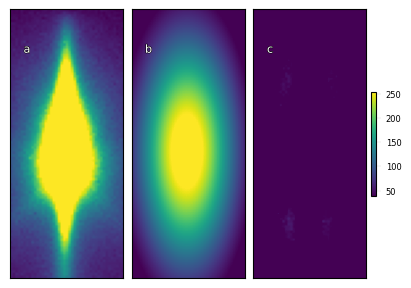

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=578037.00, img_max=255.00, img_mean=131.79,
img_rec_sum=561849.26, img_rec_max=285.05, img_rec_mean=128.10,
height=285.11, x=53.96, y=20.68, width_x=30.28, width_y_max=-12.93.


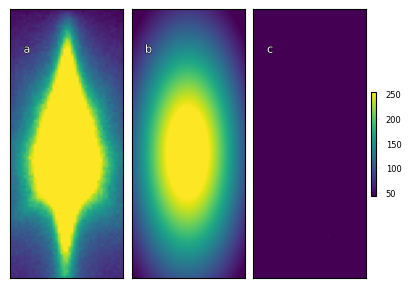

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=687028.00, img_max=255.00, img_mean=156.64,
img_rec_sum=675713.02, img_rec_max=292.23, img_rec_mean=154.06,
height=292.35, x=54.60, y=20.92, width_x=33.53, width_y_max=-15.28.


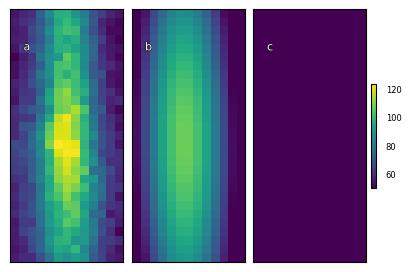

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=29602.00, img_max=124.00, img_mean=78.52,
img_rec_sum=28246.05, img_rec_max=107.25, img_rec_mean=74.92,
height=107.89, x=15.22, y=5.96, width_x=22.92, width_y_max=4.97.


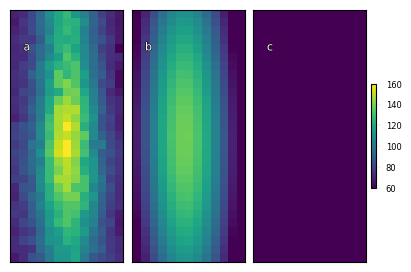

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=38014.00, img_max=160.00, img_mean=100.83,
img_rec_sum=36291.97, img_rec_max=137.75, img_rec_mean=96.27,
height=138.46, x=14.78, y=6.00, width_x=22.15, width_y_max=5.02.
DiffractedBeam_point8microAmps


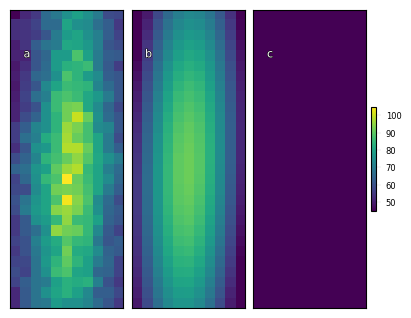

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=23058.00, img_max=105.00, img_mean=72.28,
img_rec_sum=22265.53, img_rec_max=91.62, img_rec_mean=69.80,
height=91.66, x=15.39, y=5.35, width_x=22.86, width_y_max=5.25.


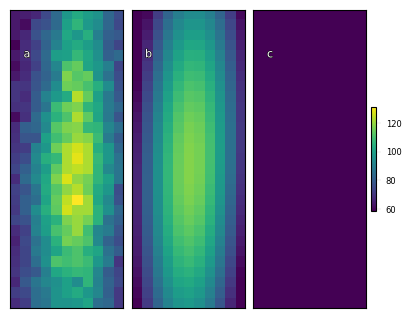

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=29546.00, img_max=131.00, img_mean=92.62,
img_rec_sum=28636.01, img_rec_max=117.74, img_rec_mean=89.77,
height=117.81, x=15.11, y=5.67, width_x=22.70, width_y_max=5.27.


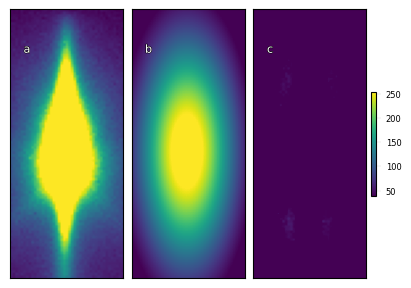

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=578037.00, img_max=255.00, img_mean=131.79,
img_rec_sum=561849.26, img_rec_max=285.05, img_rec_mean=128.10,
height=285.11, x=53.96, y=20.68, width_x=30.28, width_y_max=-12.93.


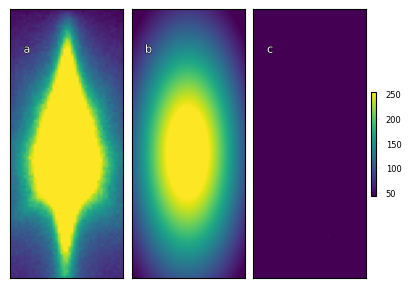

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=687028.00, img_max=255.00, img_mean=156.64,
img_rec_sum=675713.02, img_rec_max=292.23, img_rec_mean=154.06,
height=292.35, x=54.60, y=20.92, width_x=33.53, width_y_max=-15.28.


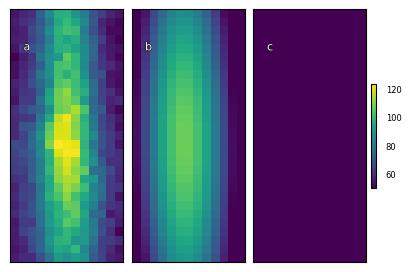

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=29602.00, img_max=124.00, img_mean=78.52,
img_rec_sum=28246.05, img_rec_max=107.25, img_rec_mean=74.92,
height=107.89, x=15.22, y=5.96, width_x=22.92, width_y_max=4.97.


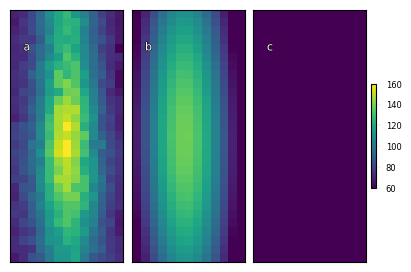

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=38014.00, img_max=160.00, img_mean=100.83,
img_rec_sum=36291.97, img_rec_max=137.75, img_rec_mean=96.27,
height=138.46, x=14.78, y=6.00, width_x=22.15, width_y_max=5.02.
DiffractedBeam_point9microAmps


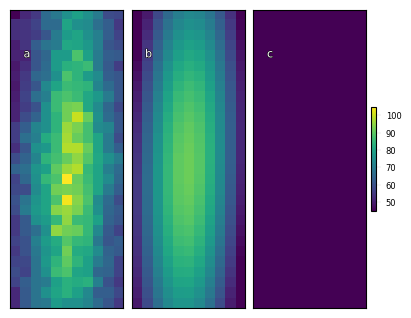

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=23058.00, img_max=105.00, img_mean=72.28,
img_rec_sum=22265.53, img_rec_max=91.62, img_rec_mean=69.80,
height=91.66, x=15.39, y=5.35, width_x=22.86, width_y_max=5.25.


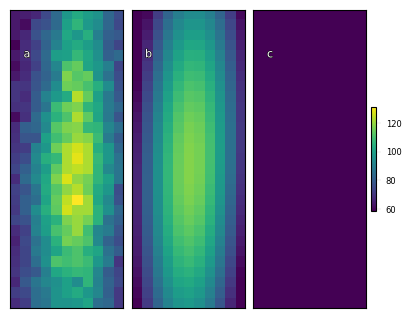

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=29546.00, img_max=131.00, img_mean=92.62,
img_rec_sum=28636.01, img_rec_max=117.74, img_rec_mean=89.77,
height=117.81, x=15.11, y=5.67, width_x=22.70, width_y_max=5.27.


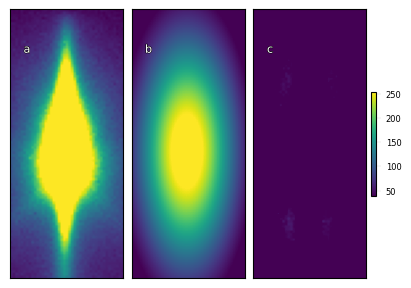

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=578037.00, img_max=255.00, img_mean=131.79,
img_rec_sum=561849.26, img_rec_max=285.05, img_rec_mean=128.10,
height=285.11, x=53.96, y=20.68, width_x=30.28, width_y_max=-12.93.


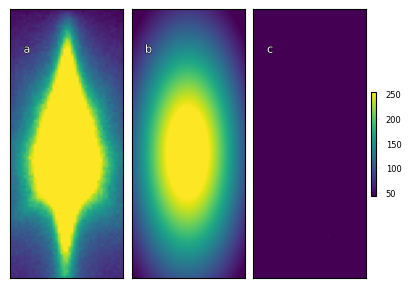

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=687028.00, img_max=255.00, img_mean=156.64,
img_rec_sum=675713.02, img_rec_max=292.23, img_rec_mean=154.06,
height=292.35, x=54.60, y=20.92, width_x=33.53, width_y_max=-15.28.


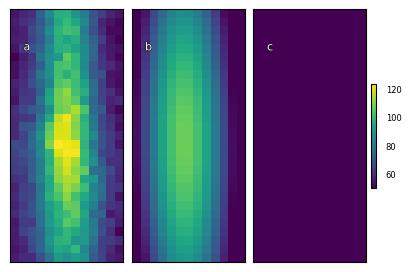

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 0.
The Gaussian fitted parameters are: img_sum=29602.00, img_max=124.00, img_mean=78.52,
img_rec_sum=28246.05, img_rec_max=107.25, img_rec_mean=74.92,
height=107.89, x=15.22, y=5.96, width_x=22.92, width_y_max=4.97.


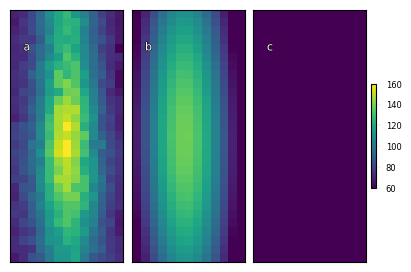

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_point7microAmps at index 21000.
The Gaussian fitted parameters are: img_sum=38014.00, img_max=160.00, img_mean=100.83,
img_rec_sum=36291.97, img_rec_max=137.75, img_rec_mean=96.27,
height=138.46, x=14.78, y=6.00, width_x=22.15, width_y_max=5.02.


In [52]:
for dataset in ds_bg.dataset_names:
    if 'Diffracted' in dataset:
        print(dataset)
        crop_dict = {'spot_1': {'y_start':116, 'y_end':145, 'x_start':234, 'x_end':245}, 
                     'spot_2': {'y_start':75, 'y_end':177, 'x_start':297, 'x_end':340}, 
                     'spot_3': {'y_start':116, 'y_end':145, 'x_start':390, 'x_end':403}}
        start_index, end_index = 0, 21000
        fit_function = Gaussian().recreate_gaussian
        processor = RHEED_image_processer(ds_bg, crop_dict, fit_function)
        img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=start_index, figsize=(4,8))
        img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_1', frame=end_index, figsize=(4,8))
        img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=start_index, figsize=(4,8))
        img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_2', frame=end_index, figsize=(4,8))
        img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=start_index, figsize=(4,8))
        img, img_rec, parameters = processor.visualize(growth=growth_name, spot='spot_3', frame=end_index, figsize=(4,8))

#### 2.2.4 preview metric in time

In [ ]:
# %%time
# fit_function = Gaussian().recreate_gaussian
# processor = RHEED_image_processer(ds_spot350C, crop_dict, fit_function)
# processor.preview_metric(growth='temp350', spot='spot_2', metric='mean', 
#                          camera_freq=2000)

#### 2.2.5 generate the dataset

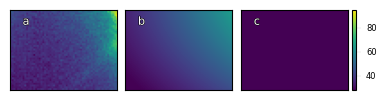

Fig. a: RHEED spot image, b: reconstructed RHEED spot image, c: difference between original and reconstructed image for DiffractedBeam_1microAmp at index 0.
img_sum=114522.00, img_max=95.00, img_mean=42.42
img_rec_sum=114505.29, img_rec_max=65.40, img_rec_mean=42.41
height=7300.11, x=-238.17, y=958.93, width_x=74.16, width_y_max=284.38


In [47]:
D1_para.viz_RHEED_parameter(growth='DiffractedBeam_1microAmp', spot='spot', index=start_index)

In [44]:
import h5py

In [49]:
parameters_file_path = 'F:/UMich/BeamCurrentLinearityTest_gaussian_fit_parameter.h5'
with h5py.File(parameters_file_path, 'a') as h5:
    print(h5.keys())
    for k in h5.keys():
        if 'Diffracted' in k:
            print(k)
#             del h5[k]

<KeysViewHDF5 ['DirectBeam_1microAmp', 'DirectBeam_point2microAmps', 'DirectBeam_point3microAmps', 'DirectBeam_point4microAmps', 'DirectBeam_point5microAmps', 'DirectBeam_point6microAmps', 'DirectBeam_point7microAmps', 'DirectBeam_point8microAmps', 'DirectBeam_point9microAmps']>


In [50]:
diffract_list = []
for k in ds_bg.dataset_names:
    if 'Diffracted' in k:
        diffract_list.append(k)

In [51]:
diffract_list

['DiffractedBeam_1microAmp',
 'DiffractedBeam_point2microAmps',
 'DiffractedBeam_point3microAmps',
 'DiffractedBeam_point4microAmps',
 'DiffractedBeam_point5microAmps',
 'DiffractedBeam_point6microAmps',
 'DiffractedBeam_point6microAmps_CORRECT',
 'DiffractedBeam_point7microAmps',
 'DiffractedBeam_point8microAmps',
 'DiffractedBeam_point9microAmps']

In [ ]:
%%time
parameters_file_path = 'F:/UMich/BeamCurrentLinearityTest_gaussian_fit_parameter.h5'

fit_function = Gaussian().recreate_gaussian
processor = RHEED_image_processer(ds_bg, crop_dict, fit_function)
processor.write_h5_file(parameters_file_path, diffract_list, replace=False, num_workers=12)

h5 file exist.
DiffractedBeam_1microAmp:
  spot_1 generation started:
    0 - 22952 ...
  spot_2 generation started:
    0 - 22952 ...
  spot_3 generation started:
    0 - 22952 ...
DiffractedBeam_point2microAmps:
  spot_1 generation started:
    0 - 21862 ...
  spot_2 generation started:
    0 - 21862 ...
  spot_3 generation started:
    0 - 21862 ...
DiffractedBeam_point3microAmps:
  spot_1 generation started:
    0 - 22336 ...
  spot_2 generation started:
    0 - 22336 ...
  spot_3 generation started:
    0 - 22336 ...
DiffractedBeam_point4microAmps:
  spot_1 generation started:
    0 - 22015 ...
  spot_2 generation started:
    0 - 22015 ...
  spot_3 generation started:
    0 - 22015 ...
DiffractedBeam_point5microAmps:
  spot_1 generation started:
    0 - 21818 ...
  spot_2 generation started:
    0 - 21818 ...
  spot_3 generation started:
    0 - 21818 ...
DiffractedBeam_point6microAmps:
  spot_1 generation started:
    0 - 22961 ...
  spot_2 generation started:
    0 - 22961 ...


#### 2.2.6 Exam the dataset

In [ ]:
parameters_file_path = 'F:/UMich/BeamCurrentLinearityTest_gaussian_fit_parameter.h5'
D1_para = RHEED_parameter_dataset(parameters_file_path, camera_freq=1000, sample_name='bg')

D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=start_index)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index//2)
D1_para.viz_RHEED_parameter(growth=growth_name, spot='spot_2', index=end_index)
D1_para.viz_RHEED_parameter_trend(diffract_list, spot='spot_2', head_tail=(100,300))